In [16]:
# ===== 라이브러리 불러오기 =====
import pandas as pd
import numpy as np
from autogluon.tabular import TabularPredictor
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

In [17]:
# 랜덤 시드 고정
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

import matplotlib.font_manager as fm

fe = fm.FontEntry(
    fname=r'/usr/share/fonts/truetype/nanum/NanumGothic.ttf', # ttf 파일이 저장되어 있는 경로
    name='NanumBarunGothic')                        # 이 폰트의 원하는 이름 설정
fm.fontManager.ttflist.insert(0, fe)              # Matplotlib에 폰트 추가
plt.rcParams.update({'font.size': 10, 'font.family': 'NanumBarunGothic'}) # 폰트 설정
plt.rc('font', family='NanumBarunGothic') 

### 1단계 : 데이터 로딩 및 기본 탐색
- gimi9-geocoder를 활용하여 아파트 위도(y)/경도(x) 좌표 획득 
    - 지오코더 API를 활용하여 위도/경도 좌표 획득하기 위해 위선 Train과 Test 데이터셋에서 addr.csv 추출 
    - get_xy.ipynb로 데이터 획득 : addr_xy.csv

In [18]:
# 데이터 파일 읽기
train_df = pd.read_csv("data/train.csv")
test_df = pd.read_csv("data/test.csv")

In [19]:
# Target 변수 분포 확인
print(f"\nTarget 변수 기본 통계 (단위: 만원)")
print(f" - 최소값: {train_df['target'].min():,.0f}")
print(f" - 최대값: {train_df['target'].max():,.0f}")
print(f" - 평균값: {train_df['target'].mean():,.0f}")
print(f" - 중앙값: {train_df['target'].median():,.0f}")
print(f" - 표준편차: {train_df['target'].std():,.0f}")


Target 변수 기본 통계 (단위: 만원)
 - 최소값: 350
 - 최대값: 1,450,000
 - 평균값: 57,992
 - 중앙값: 44,800
 - 표준편차: 46,426


 - 왜도(Skewness): 3.5176 (양수 = 오른쪽 꼬리가 긴 분포)


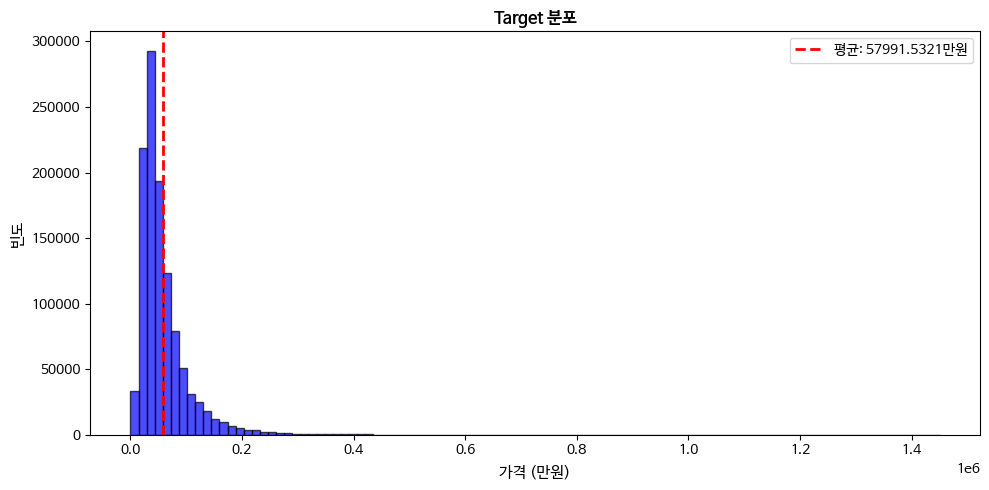

In [20]:
# Target 분포 확인 (왜도)
from scipy import stats
skewness = stats.skew(train_df['target'])
print(f" - 왜도(Skewness): {skewness:.4f} (양수 = 오른쪽 꼬리가 긴 분포)")

plt.figure(figsize=(10, 5))

plt.hist(train_df['target'], bins=100, alpha=0.7, color='blue', edgecolor='black')
plt.xlabel('가격 (만원)', fontsize=11)
plt.ylabel('빈도', fontsize=11)
plt.title('Target 분포', fontsize=12, fontweight='bold')
plt.axvline(train_df['target'].mean(), color='red', linestyle='--', linewidth=2, label=f"평균: {train_df['target'].mean():.4f}만원")
plt.legend()
plt.tight_layout()
plt.show()

In [21]:
# Target 로그 변환 (Right Skewness 완화 : np.log1p 적용)

target_original = train_df['target'].copy()

train_df['target'] = np.log1p(train_df['target'])
skewness_after = stats.skew(train_df['target'])
print(f" - 로그 변환 후 왜도: {skewness_after:.4f}")
print(f" - 왜도 감소: {skewness:.4f} → {skewness_after:.4f}")

 - 로그 변환 후 왜도: 0.2813
 - 왜도 감소: 3.5176 → 0.2813


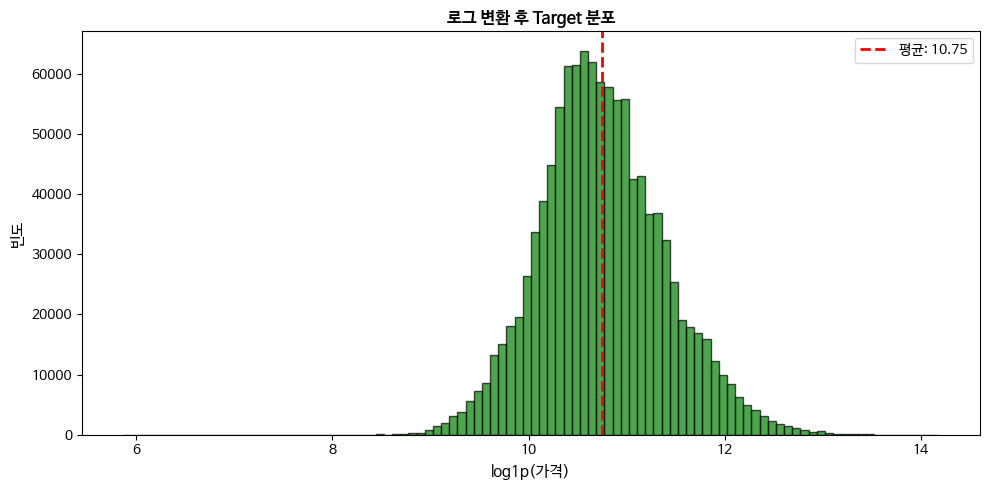

In [22]:
plt.figure(figsize=(10, 5))

plt.hist(train_df['target'], bins=100, alpha=0.7, color='green', edgecolor='black')
plt.xlabel('log1p(가격)', fontsize=11)
plt.ylabel('빈도', fontsize=11)
plt.title('로그 변환 후 Target 분포', fontsize=12, fontweight='bold')
plt.axvline(train_df['target'].mean(), color='red', linestyle='--', linewidth=2, 
            label=f"평균: {train_df['target'].mean():.2f}")
plt.legend()
plt.tight_layout()
plt.show()

### 2단계: 이상치 제거 (Train 데이터만)
- 조건 1: '층' <= 0 인 행 : 데이터 확인해 보니 지상층을 지하층으로 잘못 기재한 것으로 판단되어 음수를 양수로 변환 
- 조건 2: 'target' <= log1p(10,000) 이하 AND '전용면적(㎡)' >= 60 인 행 삭제 : 삭제 대상으로 애매하여 보류
- 조건 3: IQR을 활용하여 Target의 Q1 - 1.5 * IQR 만 삭제 처리(최대 가격은 해당 시점에 가능한 거래 금액으로 판단됨 )

In [23]:
# 조건 1: 층 <= 0 인 데이터 확인 
print(f" - 층 <= 0: {len(train_df[train_df['층'] <= 0])}개\n")
print(train_df[train_df['층'] <= 0].groupby('아파트명')['층'].count().sort_values(ascending=False))

# 테스트 데이터셋 확인 => 처리 보류(테스트 데이터 셋은 실제 예측 대상이므로)
# print(f"\n\n{test_df[test_df['층'] <= 0].groupby('아파트명')['층'].count().sort_values(ascending=False)}")

# 특정 아파트명에 대한 행을 DataFrame 형태로 추출하여 출력
result = train_df[['시군구', '아파트명', '층', '건축년도', '계약년월', '전용면적(㎡)', 'target']].query("층 <= 1 and 아파트명 == '우물골2단지두산위브BL2-7'")
result.head(10)


 - 층 <= 0: 261개

아파트명
우물골2단지두산위브BL2-7    42
한남더힐               18
강변                 11
신신                 11
한성1                11
                   ..
푸른숲                 1
하영                  1
프리젠트빌               1
한강빌라                1
휘경                  1
Name: 층, Length: 80, dtype: int64


,시군구,아파트명,층,건축년도,계약년월,전용면적(㎡),target
91159,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-3,2010,201711,134.51,11.163382
91163,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-2,2010,201801,134.48,11.002117
91170,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,1,2010,201803,84.51,11.026809
91171,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,1,2010,201803,101.53,11.074436
91181,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-3,2010,201807,101.49,11.191356
91188,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-2,2010,201808,134.48,11.238502
133315,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-1,2010,201110,101.49,11.038126
133318,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-3,2010,201201,134.51,11.072263
133319,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-4,2010,201201,134.46,11.044537
133322,서울특별시 은평구 진관동,우물골2단지두산위브BL2-7,-4,2010,201202,134.46,11.044537


In [ ]:
### 이상치 제거 기준으로 삼기에 애매한 조건들 ###
# # 조건 2: 전용면적 >= 60 이고 target <= log1p(10000) 1억원 이하인 데이터
# # print(f" - 전용면적 >= 60㎡ AND target <= log1p(10000): {len(train_df[(train_df['전용면적(㎡)'] >= 60) & (train_df['target'] <= np.log1p(10000))])}개\n")
# print(f" target <= log1p(10,000): {len(train_df[train_df['target'] <= np.log1p(1509)])}개\n")

# # 전용면적 기반 이상치 확인: threshold를 미리 계산하고 boolean 마스크로 필터링
# threshold = np.log1p(1509)
# mask = (train_df['target'] <= threshold)
# result1 = train_df.loc[mask, ['시군구', '아파트명', '층', '건축년도', '계약년월', '전용면적(㎡)', 'target']]
# result1.head(10)

# # log1p 역변환
# # print(np.expm1(7.32))


 target <= log1p(10,000): 32개



,시군구,아파트명,층,건축년도,계약년월,전용면적(㎡),target
160743,서울특별시 노원구 상계동,성원상떼빌,10,1999,200908,114.76,7.003974
197746,서울특별시 은평구 구산동,신호,9,2008,200812,88.93,6.594413
197747,서울특별시 은평구 구산동,신호,7,2008,200812,83.70,6.594413
197748,서울특별시 은평구 구산동,신호,2,2008,200812,83.70,6.493754
197749,서울특별시 은평구 구산동,신호,7,2008,200812,100.53,6.734592
197750,서울특별시 은평구 구산동,신호,6,2008,200812,100.53,6.710523
197751,서울특별시 은평구 구산동,신호,6,2008,200812,83.70,6.566672
197752,서울특별시 은평구 구산동,신호,3,2008,200812,100.53,6.685861
197753,서울특별시 은평구 구산동,신호,4,2008,200812,100.53,6.698268
197754,서울특별시 은평구 구산동,신호,8,2008,200812,100.53,6.734592


In [24]:
# Plotly로 박스플롯 그리기 (로그 스케일과 원본 스케일)

# train_df에 target이 존재하는지 확인하고 Plotly로 출력
# 1) 로그 스케일 (train_df['target']는 이미 np.log1p 적용됨)
fig1 = px.box(train_df, y='target', points='outliers', title='Filtered rows: target (log1p)', height=800, width=600)
fig1.update_yaxes(title_text='log1p(target)')
fig1.show()

# 2) 원본 스케일: np.expm1로 역변환하여 임시 컬럼 생성 후 박스플롯
tmp = train_df.assign(target_original = np.expm1(train_df['target']))
fig2 = px.box(tmp, y='target_original', points='outliers', title='Filtered rows: target (original scale, 만원)', height=800, width=600)
fig2.update_yaxes(title_text='target (만원)')
fig2.show()

In [ ]:
### 이상치 제거 기준으로 애매함한 조건들 ###
# # 조건 2-1: 전용면적 <= 60 이고 target >= log1p(200000) 20억원 이상인 데이터
# print(f" - 전용면적 <= 60㎡ AND target >= log1p(200,000): {len(train_df[(train_df['전용면적(㎡)'] <= 60) & (train_df['target'] >= np.log1p(200000))])}개\n")

# threshold = np.log1p(200000)
# mask = (train_df['전용면적(㎡)'] <= 60) & (train_df['target'] >= threshold)
# result2 = train_df.loc[mask, ['시군구', '아파트명', '층', '건축년도', '계약년월', '전용면적(㎡)', 'target']]
# result2.head(10)

 - 전용면적 <= 60㎡ AND target >= log1p(200,000): 524개



,시군구,아파트명,층,건축년도,계약년월,전용면적(㎡),target
188,서울특별시 강남구 개포동,개포주공1단지,4,1982,201807,58.0800,12.235636
193,서울특별시 강남구 개포동,개포주공1단지,3,1982,201808,56.5700,12.240479
195,서울특별시 강남구 개포동,개포주공1단지,5,1982,201808,58.0800,12.468441
201,서울특별시 강남구 개포동,개포주공1단지,1,1982,201808,42.5500,12.254868
57064,서울특별시 서초구 반포동,래미안퍼스티지,13,2009,201807,59.9600,12.206078
57360,서울특별시 서초구 반포동,아크로리버파크,12,2016,201808,59.9800,12.254868
57369,서울특별시 서초구 반포동,아크로리버파크,9,2016,201808,59.9800,12.278398
201156,서울특별시 강남구 도곡동,도곡렉슬,11,2006,202305,59.9818,12.206078
201163,서울특별시 강남구 도곡동,도곡렉슬,20,2006,202305,59.9818,12.230770
201177,서울특별시 강남구 도곡동,래미안도곡카운티,8,2016,202305,59.9800,12.206078


In [25]:
# IQR을 활용하여 비정상적으로 낮은 매매가 이상치 제거 
def remove_outliers_iqr(dt, column_name):
    df = dt.copy()

    Q1 = df[column_name].quantile(0.25)
    Q3 = df[column_name].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    
    df = df[(df[column_name] >= lower_bound)]

    return df

In [ ]:
### 이상치 제거 ###
# 조건 1: '층' <= 0 인 행 층수를 양수로 변경 (음수는 절대값으로, 0은 1로 보정)
if '층' in train_df.columns:
    # 변경 대상 마스크
    mask = train_df['층'] <= 0
    changed = mask.sum()
    # 음수는 절대값으로 변환, 0은 1로 변경
    train_df.loc[mask, '층'] = train_df.loc[mask, '층'].abs()
    train_df.loc[train_df['층'] == 0, '층'] = 1
    print(f"조건 1: '층' <= 0 인 행 층수 양수로 변경 → {changed:,}개 행 수정")

# # 조건 2: 'target' <= log1p(10,000) 이하 AND '전용면적(㎡)' >= 60 인 행 삭제
# if 'target' in train_df.columns:
#     before = len(train_df)
#     threshold = np.log1p(10000)  # target이 로그 변환되어 있으므로
#     condition = (train_df['target'] <= threshold) & (train_df['전용면적(㎡)'] >= 60)
#     train_df = train_df[~condition].reset_index(drop=True)
#     removed = before - len(train_df)
#     print(f" 조건 2: target <= log1p(10,000) AND 전용면적 >= 60㎡ 인 행 삭제 → {removed:,}개 행 제거")

# 조건 3: 'target' <= Q1 - 1.5 * IQR 이하인 행 삭제
original_cnt = train_df.shape[0] 
if 'target' in train_df.columns:
    train_df = remove_outliers_iqr(train_df, 'target')
    print(f"조건 2: 이상치 제거 행 갯수: 총{original_cnt - train_df.shape[0]}개")

 조건 1: '층' <= 0 인 행 층수 양수로 변경 → 261개 행 수정

조건 2: 이상치 제거 행 갯수: 총2472개


In [30]:
train_df.shape

(1116350, 52)

### 3단계: Train/Test 합치기 및 변수명 정리
- **데이터 누수 방지를 위하여 target 제외**

In [27]:
# test_yn 컬럼 추가
train_df['test_yn'] = 0
test_df['test_yn'] = 1

# target 분리 저장
y_train = train_df['target'].copy()
train_df = train_df.drop('target', axis=1)

# 데이터 합치기 (데이터 누수를 방지하기 위하여 target 제외)
full_df = pd.concat([train_df, test_df], axis=0, ignore_index=True)
print(f" 합친 데이터: {full_df.shape[0]:,}행 x {full_df.shape[1]:,}열")


 합친 데이터: 1,125,622행 x 52열


In [31]:
# 변수명 정리 (특수기호 제거)
rename_dict = {
    '전용면적(㎡)': '전용면적',
    'k-전용면적별세대현황(60㎡이하)': 'k-전용면적(60이하)',
    'k-전용면적별세대현황(60㎡~85㎡이하)': 'k-전용면적(60~85이하)',
    'k-85㎡~135㎡이하': 'k-전용면적(85~135이하)',
    'k-135㎡초과': 'k-전용면적(135이상)'
}

# 실제 존재하는 컬럼만 rename
rename_dict_exist = {k: v for k, v in rename_dict.items() if k in full_df.columns}
full_df = full_df.rename(columns=rename_dict_exist)
print(f" 변수명 정리: {len(rename_dict_exist)}개 컬럼 이름 변경")
for old, new in rename_dict_exist.items():
    print(f"   - '{old}' → '{new}'")

 변수명 정리: 5개 컬럼 이름 변경
   - '전용면적(㎡)' → '전용면적'
   - 'k-전용면적별세대현황(60㎡이하)' → 'k-전용면적(60이하)'
   - 'k-전용면적별세대현황(60㎡~85㎡이하)' → 'k-전용면적(60~85이하)'
   - 'k-85㎡~135㎡이하' → 'k-전용면적(85~135이하)'
   - 'k-135㎡초과' → 'k-전용면적(135이상)'


### 4단계: 좌표 결측치 보완
- 지오코더를 통해 획득한 x,y 좌표를 데이터셋에 반영

In [32]:
# 지오코더로 획득한 아파트(법정동 주소 기반) 위도/경도 정보
addr_xy_df = pd.read_csv("data/addr_xy.csv")

In [33]:
# 좌표 결측치 확인
if '좌표X' in full_df.columns and '좌표Y' in full_df.columns:
    missing_coords = full_df['좌표X'].isnull() | full_df['좌표Y'].isnull()
    print(f"좌표 결측치: {missing_coords.sum():,}개")
    
    if missing_coords.sum() > 0:
        # addr_xy_df에서 주소 기준으로 매핑
        # addr_xy.csv는 시군구, 본번, 부번으로 구성되어 있음 (이파일은 get_xy.ipynb로 생성)
        if '시군구' in full_df.columns and '본번' in full_df.columns and '부번' in full_df.columns:
            # full_df에서 주소 키 생성 (float → int → str)
            full_df['주소_key'] = (
                full_df['시군구'].astype(str) + '_' + 
                full_df['본번'].fillna(-999).astype(int).astype(str) + '_' + 
                full_df['부번'].fillna(-999).astype(int).astype(str)
            )
            
            # addr_xy_df도 동일하게 주소 키 생성 (int → str)
            if '시군구' in addr_xy_df.columns and '본번' in addr_xy_df.columns and '부번' in addr_xy_df.columns:
                addr_xy_df['주소_key'] = (
                    addr_xy_df['시군구'].astype(str) + '_' + 
                    addr_xy_df['본번'].fillna(-999).astype(int).astype(str) + '_' + 
                    addr_xy_df['부번'].fillna(-999).astype(int).astype(str)
                )
                
                # 딕셔너리로 변환 (first : 중복 주소는 첫 번째 좌표 사용)
                addr_to_xy = addr_xy_df.groupby('주소_key').agg({'좌표X': 'first', '좌표Y': 'first'}).to_dict()
                
                # 결측치가 있는 곳만 채우기
                filled_count = 0
                for idx in full_df[missing_coords].index:
                    addr_key = full_df.loc[idx, '주소_key']
                    if addr_key in addr_to_xy['좌표X']:
                        full_df.loc[idx, '좌표X'] = addr_to_xy['좌표X'][addr_key]
                        full_df.loc[idx, '좌표Y'] = addr_to_xy['좌표Y'][addr_key]
                        filled_count += 1
                
                print(f" {filled_count:,}개 좌표 결측치 보완 완료")
                
                # 임시 컬럼 제거
                full_df = full_df.drop('주소_key', axis=1)
            else:
                print(" addr_xy.csv에 필요한 컬럼이 없습니다 (시군구, 본번, 부번)")
        else:
            print(" full_df에 필요한 컬럼이 없습니다 (시군구, 본번, 부번)")
        
        # 여전히 남은 결측치 확인
        missing_coords_after = full_df['좌표X'].isnull() | full_df['좌표Y'].isnull()
        print(f" - 남은 좌표 결측치: {missing_coords_after.sum():,}개")

좌표 결측치: 873,886개
 873,811개 좌표 결측치 보완 완료
 - 남은 좌표 결측치: 75개


### 5단계: 결측치 처리
- 5-1. 의미 없는 데이터로 채워진 컬럼 삭제
- 5-2. 결측치 1,000,000개 이상인 컬럼 삭제
- 5-3. 변수 타입 수정
- 5-4. 범주형/연속형 변수 결측치 보간  

In [35]:
# 5-1. 의미 없는 데이터로 채워진 컬럼 삭제

meaningless_cols = ['등기신청일자', '거래유형', '중개사소재지']
meaningless_cols_exist = [col for col in meaningless_cols if col in full_df.columns]
if meaningless_cols_exist:
    full_df = full_df.drop(meaningless_cols_exist, axis=1)
    print(f" {len(meaningless_cols_exist)}개 컬럼 삭제: {meaningless_cols_exist}")
else:
    print(" 해당 컬럼 없음")

 3개 컬럼 삭제: ['등기신청일자', '거래유형', '중개사소재지']


In [36]:
# 5-2. 결측치 1,000,000개 이상인 컬럼 삭제

missing_counts = full_df.isnull().sum()
high_missing_cols = missing_counts[missing_counts >= 1000000].index.tolist()
if high_missing_cols:
    full_df = full_df.drop(high_missing_cols, axis=1)
    print(f" {len(high_missing_cols)}개 컬럼 삭제")
    for col in high_missing_cols:
        print(f"   - {col}: {missing_counts[col]:,}개")
else:
    print(" 해당 컬럼 없음")

 해당 컬럼 없음


In [37]:
# 5-3. 변수 타입 수정

for col in ['본번', '부번']:
    if col in full_df.columns:
        # 먼저 숫자로 변환 시도 (결측치는 -999로 채움)
        full_df[col] = pd.to_numeric(full_df[col], errors='coerce').fillna(-999).astype(int)
        # 문자열로 변환
        full_df[col] = full_df[col].astype(str)
        print(f" '{col}': 정수 → 문자열 변환")

 '본번': 정수 → 문자열 변환
 '부번': 정수 → 문자열 변환


In [38]:
# 5-4. 범주형/연속형 변수 결측치 보간

# 좌표는 반드시 숫자형으로 유지
if '좌표X' in full_df.columns:
    full_df['좌표X'] = pd.to_numeric(full_df['좌표X'], errors='coerce')
if '좌표Y' in full_df.columns:
    full_df['좌표Y'] = pd.to_numeric(full_df['좌표Y'], errors='coerce')

# 범주형 변수: 'NULL'로 채우기
categorical_cols = full_df.select_dtypes(include=['object']).columns
for col in categorical_cols:
    if full_df[col].isnull().sum() > 0:
        full_df[col] = full_df[col].fillna('NULL')

print(f" 범주형 변수 {len(categorical_cols)}개: 'NULL'로 채움")

# 연속형 변수: 선형 보간 + 중앙값
numeric_cols = full_df.select_dtypes(include=[np.number]).columns
for col in numeric_cols:
    if full_df[col].isnull().sum() > 0:
        # 선형 보간
        full_df[col] = full_df[col].interpolate(method='linear', limit_direction='both')
        # 남은 결측치는 중앙값으로
        if full_df[col].isnull().sum() > 0:
            full_df[col] = full_df[col].fillna(full_df[col].median())

print(f" 연속형 변수 {len(numeric_cols)}개: 선형보간 + 중앙값")

 범주형 변수 26개: 'NULL'로 채움
 연속형 변수 18개: 선형보간 + 중앙값


In [39]:
# 최종 결측치 확인
remaining_nulls = full_df.isnull().sum().sum()
print(f" - 남은 결측치: {remaining_nulls:,}개")

 - 남은 결측치: 0개


### 6단계: 파생변수 생성
- 6-1. 지역 변수
- 6-2. 시간 변수 (아파트 나이)
- 6-3. 재건축/리모델링 여부
- 6-4. 면적 변수
- 6-5. 단지 변수
- 6-6. 층고 변수
- 6-7. 역세권 변수 (Haversine 공식 - 벡터화)
- 6-8. 시차 변수 (구/동별 그룹화) - 거래량 고려

In [40]:
# 6-1. 지역 변수

if '시군구' in full_df.columns:
    # '구'와 '동' 분리
    full_df['구'] = full_df['시군구'].str.split().str[-1]
    # 시군구에서 '구' 앞부분을 '동'으로 추출
    full_df['동'] = full_df['시군구'].str.split().str[:-1].str.join(' ')

In [41]:
# 6-2. 시간 변수

if '계약년월' in full_df.columns:
    full_df['계약년'] = full_df['계약년월'] // 100
    full_df['계약월'] = full_df['계약년월'] % 100
    print(f" '계약년', '계약월' 분리")

if '건축년도' in full_df.columns and '계약년' in full_df.columns:
    full_df['아파트나이'] = full_df['계약년'] - full_df['건축년도']
    full_df['아파트나이'] = full_df['아파트나이'].clip(lower=0)  # 음수 방지
    print(f" '아파트나이' 생성 (음수 방지)")
    
    # 신축 여부 (10년 이내)
    full_df['신축'] = (full_df['아파트나이'] <= 10).astype(int)
    print(f" '신축' 여부: 10년 이내(1) / 아님(0)")
    
    # 노후 여부 (30년 이상)
    full_df['노후'] = (full_df['아파트나이'] >= 30).astype(int)
    print(f" '노후' 여부: 30년 이상(1) / 아님(0)")

 '계약년', '계약월' 분리
 '아파트나이' 생성 (음수 방지)
 '신축' 여부: 10년 이내(1) / 아님(0)
 '노후' 여부: 30년 이상(1) / 아님(0)


In [42]:
# 6-3. 재건축/리모델링 여부

if 'k-시행사' in full_df.columns:
    keywords = ['재건축', '리모델링']
    full_df['재건축리모델링'] = full_df['k-시행사'].str.contains(
        '|'.join(keywords), case=False, na=False
    ).astype(int)
    print(f" '재건축리모델링' 여부 생성")

 '재건축리모델링' 여부 생성


In [43]:
# 6-3. 면적 변수
# 중형 아파트의 평당 가격이 가장 높기 때문에 중형 아파트의 가격을 기준으로 면적 변수 생성

if '전용면적' in full_df.columns:
    # 평형 구간
    full_df['평형'] = pd.cut(
        full_df['전용면적'],
        bins=[0, 60, 85, 135, 1000],
        labels=['소형', '중형', '중대형', '대형']
    )
    print(f" '평형' 구간: 소형(<60㎡), 중형(60~85㎡), 중대형(85~135㎡), 대형(135㎡~)")

 '평형' 구간: 소형(<60㎡), 중형(60~85㎡), 중대형(85~135㎡), 대형(135㎡~)


In [44]:
# 6-4. 단지 변수
# 아파트 브랜드와 대단지 여부, 주상복합 여부에 따라 가격차 발생 

if 'k-전체세대수' in full_df.columns:
    full_df['대단지'] = (full_df['k-전체세대수'] >= 500).astype(int)
    print(f" '대단지' 여부: 500세대 이상(1) / 아님(0)")

if '아파트명' in full_df.columns:
    brand_keywords = ['래미안', '힐스테이트', '자이', 'e편한세상', '푸르지오', '아이파크', 
                     '더샵', '롯데캐슬', '디에이치', '센트럴', '파크', '트리', '포레']
    full_df['브랜드아파트'] = full_df['아파트명'].str.contains(
        '|'.join(brand_keywords), case=False, na=False
    ).astype(int)
    print(f" '브랜드아파트' 여부 생성")
    
    # 주상복합
    full_df['주상복합'] = full_df['아파트명'].str.contains('주상복합', case=False, na=False).astype(int)
    print(f" '주상복합' 여부 생성")


 '대단지' 여부: 500세대 이상(1) / 아님(0)
 '브랜드아파트' 여부 생성
 '주상복합' 여부 생성


In [45]:
# 6-5. 층고 변수
# 로얄층 여부에 따라 가격차 발생 

if '층' in full_df.columns:
    def classify_floor(floor):
        if floor <= 5:
            return '저층'
        elif floor <= 15:
            return '중층'
        else:
            return '고층'
    
    full_df['층고구간'] = full_df['층'].apply(classify_floor)
    print(f" '층고구간': 저층(≤5층), 중층(6~15층), 고층(≥16층)")

 '층고구간': 저층(≤5층), 중층(6~15층), 고층(≥16층)


In [46]:
bus_df = pd.read_csv("data/bus_feature.csv")
subway_df = pd.read_csv("data/subway_feature.csv")

In [47]:
# 6-6. 역세권 변수 (Haversine 공식 - 벡터화)
# 역세권 여부에 따라 가격차 발생 

def haversine_vectorized(lat1, lon1, lat2, lon2):
    """벡터화된 Haversine 거리 계산 (km)"""
    R = 6371  # 지구 반지름 (km)
    
    # 라디안 변환
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    
    # Haversine 공식
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    
    return R * c

In [48]:
# 지하철역 변수
# 500m 이내 지하철역 수에 따라 가격차 발생 
# 500m 이내 버스정류소 수를 고려하여 교통편의성 점수를 반영 

if '좌표X' in full_df.columns and '좌표Y' in full_df.columns:
    # 좌표를 명시적으로 숫자형으로 변환
    full_df['좌표X'] = pd.to_numeric(full_df['좌표X'], errors='coerce')
    full_df['좌표Y'] = pd.to_numeric(full_df['좌표Y'], errors='coerce')
    
    subway_coords = subway_df[['경도', '위도']].values
    apt_lons = full_df['좌표X'].values
    apt_lats = full_df['좌표Y'].values
    
    subway_count_500m = np.zeros(len(full_df), dtype=int)
    
    # 배치 처리
    batch_size = 5000
    n_batches = int(np.ceil(len(full_df) / batch_size))
    
    for batch_idx in range(n_batches):
        start_idx = batch_idx * batch_size
        end_idx = min((batch_idx + 1) * batch_size, len(full_df))
        
        if (batch_idx + 1) % 10 == 0:
            print(f"   지하철 계산 진행: {batch_idx+1}/{n_batches} 배치")
        
        batch_lons = apt_lons[start_idx:end_idx]
        batch_lats = apt_lats[start_idx:end_idx]
        
        valid_mask = ~(np.isnan(batch_lons) | np.isnan(batch_lats))
        valid_indices = np.where(valid_mask)[0]
        
        if len(valid_indices) == 0:
            continue
        
        valid_lons = batch_lons[valid_indices]
        valid_lats = batch_lats[valid_indices]
        
        for i, (apt_lon, apt_lat) in enumerate(zip(valid_lons, valid_lats)):
            distances = haversine_vectorized(
                apt_lat, apt_lon,
                subway_coords[:, 1], subway_coords[:, 0]
            )
            global_idx = start_idx + valid_indices[i]
            subway_count_500m[global_idx] = np.sum(distances <= 0.5)
    
    full_df['지하철역수_500m'] = subway_count_500m
    full_df['역세권여부'] = (full_df['지하철역수_500m'] >= 1).astype(int)
    print(f" 지하철역 변수 생성 완료")
    
    # 버스 정류소 변수
    bus_coords = bus_df[['X좌표', 'Y좌표']].values
    bus_count_500m = np.zeros(len(full_df), dtype=int)
    
    for batch_idx in range(n_batches):
        start_idx = batch_idx * batch_size
        end_idx = min((batch_idx + 1) * batch_size, len(full_df))
        
        if (batch_idx + 1) % 10 == 0:
            print(f"   버스 계산 진행: {batch_idx+1}/{n_batches} 배치")
        
        batch_lons = apt_lons[start_idx:end_idx]
        batch_lats = apt_lats[start_idx:end_idx]
        
        valid_mask = ~(np.isnan(batch_lons) | np.isnan(batch_lats))
        valid_indices = np.where(valid_mask)[0]
        
        if len(valid_indices) == 0:
            continue
        
        valid_lons = batch_lons[valid_indices]
        valid_lats = batch_lats[valid_indices]
        
        for i, (apt_lon, apt_lat) in enumerate(zip(valid_lons, valid_lats)):
            distances = haversine_vectorized(
                apt_lat, apt_lon,
                bus_coords[:, 1], bus_coords[:, 0]
            )
            global_idx = start_idx + valid_indices[i]
            bus_count_500m[global_idx] = np.sum(distances <= 0.5)
    
    full_df['버스정류소수_500m'] = bus_count_500m
    print(f" 버스 정류소 변수 생성 완료")
    
    # 교통편의성 점수
    full_df['교통편의성점수'] = (
        full_df['지하철역수_500m'] * 3 + 
        full_df['버스정류소수_500m'] * 0.5
    )
    print(f" '교통편의성점수' 생성")

   지하철 계산 진행: 10/226 배치
   지하철 계산 진행: 20/226 배치
   지하철 계산 진행: 30/226 배치
   지하철 계산 진행: 40/226 배치
   지하철 계산 진행: 50/226 배치
   지하철 계산 진행: 60/226 배치
   지하철 계산 진행: 70/226 배치
   지하철 계산 진행: 80/226 배치
   지하철 계산 진행: 90/226 배치
   지하철 계산 진행: 100/226 배치
   지하철 계산 진행: 110/226 배치
   지하철 계산 진행: 120/226 배치
   지하철 계산 진행: 130/226 배치
   지하철 계산 진행: 140/226 배치
   지하철 계산 진행: 150/226 배치
   지하철 계산 진행: 160/226 배치
   지하철 계산 진행: 170/226 배치
   지하철 계산 진행: 180/226 배치
   지하철 계산 진행: 190/226 배치
   지하철 계산 진행: 200/226 배치
   지하철 계산 진행: 210/226 배치
   지하철 계산 진행: 220/226 배치
 지하철역 변수 생성 완료
   버스 계산 진행: 10/226 배치
   버스 계산 진행: 20/226 배치
   버스 계산 진행: 30/226 배치
   버스 계산 진행: 40/226 배치
   버스 계산 진행: 50/226 배치
   버스 계산 진행: 60/226 배치
   버스 계산 진행: 70/226 배치
   버스 계산 진행: 80/226 배치
   버스 계산 진행: 90/226 배치
   버스 계산 진행: 100/226 배치
   버스 계산 진행: 110/226 배치
   버스 계산 진행: 120/226 배치
   버스 계산 진행: 130/226 배치
   버스 계산 진행: 140/226 배치
   버스 계산 진행: 150/226 배치
   버스 계산 진행: 160/226 배치
   버스 계산 진행: 170/226 배치
   버스 계산 진행: 180/226 배치
   버스 계산 진행: 190/226 

In [49]:
# 6-7. 시차 변수 (구/동별 그룹화) - 거래량 고려

if '구' in full_df.columns and '동' in full_df.columns and '계약년월' in full_df.columns:
    # test_yn으로 분리하여 train에만 target 추가
    temp_df = full_df.copy()
    temp_df['target'] = np.nan
    
    # train 부분에만 target 추가
    train_mask = temp_df['test_yn'] == 0
    temp_df.loc[train_mask, 'target'] = y_train.values
    
    # 계약년월 기준 정렬
    temp_df = temp_df.sort_values(['구', '동', '계약년월']).reset_index(drop=True)
    
    # 구/동별 그룹화하여 시차 변수 생성
    # === 가. 거래량 변수 생성 ===
   
    # 동별 월별 거래량 (train 데이터만 사용)
    train_only = temp_df[temp_df['target'].notna()].copy()
    
    # 동별 월별 거래량 계산
    volume_dong_month = train_only.groupby(['구', '동', '계약년월']).size().reset_index(name='거래량_동_월')
    temp_df = temp_df.merge(volume_dong_month, on=['구', '동', '계약년월'], how='left')
    temp_df['거래량_동_월'] = temp_df['거래량_동_월'].fillna(0)
    
    # 동별 총 거래량
    volume_dong = train_only.groupby(['구', '동']).size().reset_index(name='거래량_동_총')
    temp_df = temp_df.merge(volume_dong, on=['구', '동'], how='left')
    temp_df['거래량_동_총'] = temp_df['거래량_동_총'].fillna(0)
    
    # 구별 월별 거래량
    volume_gu_month = train_only.groupby(['구', '계약년월']).size().reset_index(name='거래량_구_월')
    temp_df = temp_df.merge(volume_gu_month, on=['구', '계약년월'], how='left')
    temp_df['거래량_구_월'] = temp_df['거래량_구_월'].fillna(0)
    
    print(f" 거래량 변수 3개 생성 완료")
    
    # === 나. 거래량 기반 신뢰도 점수 ===
    # 신뢰도 점수: 거래량이 많을수록 높음 (0~1 사이로 정규화)
    temp_df['신뢰도_동_월'] = np.clip(temp_df['거래량_동_월'] / 10, 0, 1)  # 10건 이상이면 신뢰도 1
    temp_df['신뢰도_동_총'] = np.clip(temp_df['거래량_동_총'] / 100, 0, 1)  # 100건 이상이면 신뢰도 1
    
    print(f" 신뢰도 점수 2개 생성 완료")
    
    # === 다. 기본 시차 변수 (거래량 고려 X) ===
    # price_lag_1, 2, 3: 1~3개월 전 평균 가격
    # price_rolling_mean_3: 최근 3개월 이동평균
    # nearby_region_avg: 구별 평균 가격

    for lag in [1, 2, 3]:
        temp_df[f'price_lag_{lag}'] = temp_df.groupby(['구', '동'])['target'].shift(lag)
    
    # price_rolling_mean_3: 최근 3개월 이동평균
    temp_df['price_rolling_mean_3'] = temp_df.groupby(['구', '동'])['target'].transform(
        lambda x: x.rolling(window=3, min_periods=1).mean()
    )
    
    # === 라. 거래량 기반 가중 평균 (nearby_region_avg_weighted) === 
    # 동별 가중 평균 (거래량이 적으면 구 평균 사용)
    # 최소 거래량 임계값

    MIN_VOLUME_THRESHOLD = 5  # 월별 5건 미만이면 신뢰도 낮음
    
    # 구별 평균 (fallback용)
    gu_avg = train_only.groupby('구')['target'].mean().to_dict()
    
    # 동별 평균 계산 (거래량 고려)
    dong_stats = train_only.groupby(['구', '동']).agg({
        'target': ['mean', 'count']
    }).reset_index()
    dong_stats.columns = ['구', '동', 'dong_mean', 'dong_count']
    
    temp_df = temp_df.merge(dong_stats, on=['구', '동'], how='left')
    
    # 거래량이 적으면 구 평균 사용, 많으면 동 평균 사용 (가중 평균)
    temp_df['구_평균'] = temp_df['구'].map(gu_avg)
    
    # 가중치 계산 (거래량이 많을수록 동 평균 가중치 높음)
    temp_df['dong_weight'] = np.clip(temp_df['dong_count'] / 20, 0, 1)  # 20건 이상이면 완전히 동 평균 사용
    temp_df['gu_weight'] = 1 - temp_df['dong_weight']
    
    # 가중 평균 계산
    temp_df['nearby_region_avg_weighted'] = (
        temp_df['dong_mean'].fillna(temp_df['구_평균']) * temp_df['dong_weight'] +
        temp_df['구_평균'] * temp_df['gu_weight']
    )
    
    # 기존 방식도 유지 (비교용)
    temp_df['nearby_region_avg'] = temp_df['구_평균']

    
    # 거래량이 적은 동 표시 (이상치 위험 경고)
    temp_df['저거래량_동'] = (temp_df['거래량_동_총'] < 50).astype(int)  # 총 50건 미만
    print(f" 저거래량 동 표시 완료")
    
    # 임시 컬럼 제거
    temp_df = temp_df.drop(['dong_mean', 'dong_count', '구_평균', 'dong_weight', 'gu_weight'], axis=1)
    
    # 원래 인덱스로 복원
    temp_df = temp_df.sort_index()

 거래량 변수 3개 생성 완료
 신뢰도 점수 2개 생성 완료
 저거래량 동 표시 완료


In [ ]:
# 거래량 임계치 등 확인 필요 

In [50]:
# full_df에 시차 변수 추가
time_series_cols = [
    'price_lag_1', 'price_lag_2', 'price_lag_3', 
    'price_rolling_mean_3', 
    'nearby_region_avg',
    'nearby_region_avg_weighted',
    '거래량_동_월', '거래량_동_총', '거래량_구_월',
    '신뢰도_동_월', '신뢰도_동_총',
    '저거래량_동'
]
    
for col in time_series_cols:
    if col in temp_df.columns:
        full_df[col] = temp_df[col].values 

### 7단계: 불필요한 변수 삭제

In [51]:
full_df.columns

Index(['시군구', '번지', '본번', '부번', '아파트명', '전용면적', '계약년월', '계약일', '층', '건축년도',
       '도로명', 'k-단지분류(아파트,주상복합등등)', 'k-전화번호', 'k-팩스번호', 'k-세대타입(분양형태)',
       'k-관리방식', 'k-복도유형', 'k-난방방식', 'k-전체동수', 'k-전체세대수', 'k-건설사(시공사)',
       'k-시행사', 'k-사용검사일-사용승인일', 'k-연면적', 'k-주거전용면적', 'k-관리비부과면적',
       'k-전용면적(60이하)', 'k-전용면적(60~85이하)', 'k-전용면적(85~135이하)', 'k-수정일자',
       '고용보험관리번호', '경비비관리형태', '세대전기계약방법', '청소비관리형태', '건축면적', '주차대수',
       '기타/의무/임대/임의=1/2/3/4', '단지승인일', '사용허가여부', '관리비 업로드', '좌표X', '좌표Y',
       '단지신청일', 'test_yn', '구', '동', '계약년', '계약월', '아파트나이', '신축', '노후',
       '재건축리모델링', '평형', '대단지', '브랜드아파트', '주상복합', '층고구간', '지하철역수_500m', '역세권여부',
       '버스정류소수_500m', '교통편의성점수', 'price_lag_1', 'price_lag_2', 'price_lag_3',
       'price_rolling_mean_3', 'nearby_region_avg',
       'nearby_region_avg_weighted', '거래량_동_월', '거래량_동_총', '거래량_구_월',
       '신뢰도_동_월', '신뢰도_동_총', '저거래량_동'],
      dtype='object')

In [55]:
drop_cols = [
    '시군구', '번지', '본번', '부번', '계약년월', '도로명', 'k-단지분류(아파트,주상복합등등)', 'k-전화번호', 'k-팩스번호', 'k-세대타입(분양형태)',
    'k-관리방식', 'k-전체동수', 'k-건설사(시공사)', 'k-시행사', 'k-사용검사일-사용승인일', 'k-연면적', 'k-주거전용면적', 
    'k-관리비부과면적', 'k-전용면적(60이하)', 'k-전용면적(60~85이하)', 'k-전용면적(85~135이하)', 'k-수정일자',
    '고용보험관리번호', '경비비관리형태', '세대전기계약방법', '청소비관리형태', 
    '기타/의무/임대/임의=1/2/3/4', '단지승인일', '사용허가여부', '관리비 업로드', '단지신청일',
    '거래량_구_월', 'nearby_region_avg', 'price_lag_1', 'price_lag_2'
]

# 실제 존재하는 컬럼만 삭제
drop_cols_exist = [col for col in drop_cols if col in full_df.columns]
full_df = full_df.drop(drop_cols_exist, axis=1)

print(f" {len(drop_cols_exist)}개 변수 삭제 완료")
print(f" - 남은 변수 개수: {full_df.shape[1]}개")

 6개 변수 삭제 완료
 - 남은 변수 개수: 38개


### 8단계: 상관관계 분석 및 시각화 

In [56]:
# Train 데이터만 분리 (상관관계 분석용)
train_mask = full_df['test_yn'] == 0
train_for_corr = full_df[train_mask].copy()
train_for_corr['target'] = y_train.values

# 파생변수 제작으로 추가된 변수들이 존재하기에, 다시한번 연속형과 범주형 칼럼을 분리해주겠습니다.
continuous_columns_v2 = []
categorical_columns_v2 = []

for column in train_for_corr.columns:
    if pd.api.types.is_numeric_dtype(train_for_corr[column]):
        continuous_columns_v2.append(column)
    else:
        categorical_columns_v2.append(column)

print("연속형 변수:", continuous_columns_v2)
print("범주형 변수:", categorical_columns_v2)

연속형 변수: ['전용면적', '계약일', '층', '건축년도', 'k-전체세대수', '건축면적', '주차대수', '좌표X', '좌표Y', 'test_yn', '계약년', '계약월', '아파트나이', '신축', '노후', '재건축리모델링', '대단지', '브랜드아파트', '주상복합', '지하철역수_500m', '역세권여부', '버스정류소수_500m', '교통편의성점수', 'price_lag_3', 'price_rolling_mean_3', 'nearby_region_avg_weighted', '거래량_동_월', '거래량_동_총', '신뢰도_동_월', '신뢰도_동_총', '저거래량_동', 'target']
범주형 변수: ['아파트명', 'k-복도유형', 'k-난방방식', '구', '동', '평형', '층고구간']


    1. 전용면적                          : 0.6254
    2. 계약년                           : 0.3971
    3. 좌표Y                           : 0.3457
    4. 브랜드아파트                        : 0.2625
    5. 주차대수                          : 0.1951
    6. 노후                            : 0.1932
    7. 재건축리모델링                       : 0.1672
    8. 층                             : 0.1609
    9. 버스정류소수_500m                   : 0.1606
   10. k-전체세대수                       : 0.1352
   11. 지하철역수_500m                    : 0.1071
   12. 좌표X                           : 0.1017
   13. 교통편의성점수                       : 0.0964
   14. 역세권여부                         : 0.0914
   15. 아파트나이                         : 0.0879
   16. 건축년도                          : 0.0876
   17. 대단지                           : 0.0850
   18. 계약월                           : 0.0534
   19. nearby_region_avg_weighted    : 0.0461
   20. 거래량_동_총                       : 0.0461
   21. 거래량_동_월                       : 0.0438
   22. price_rolling_mean_3       

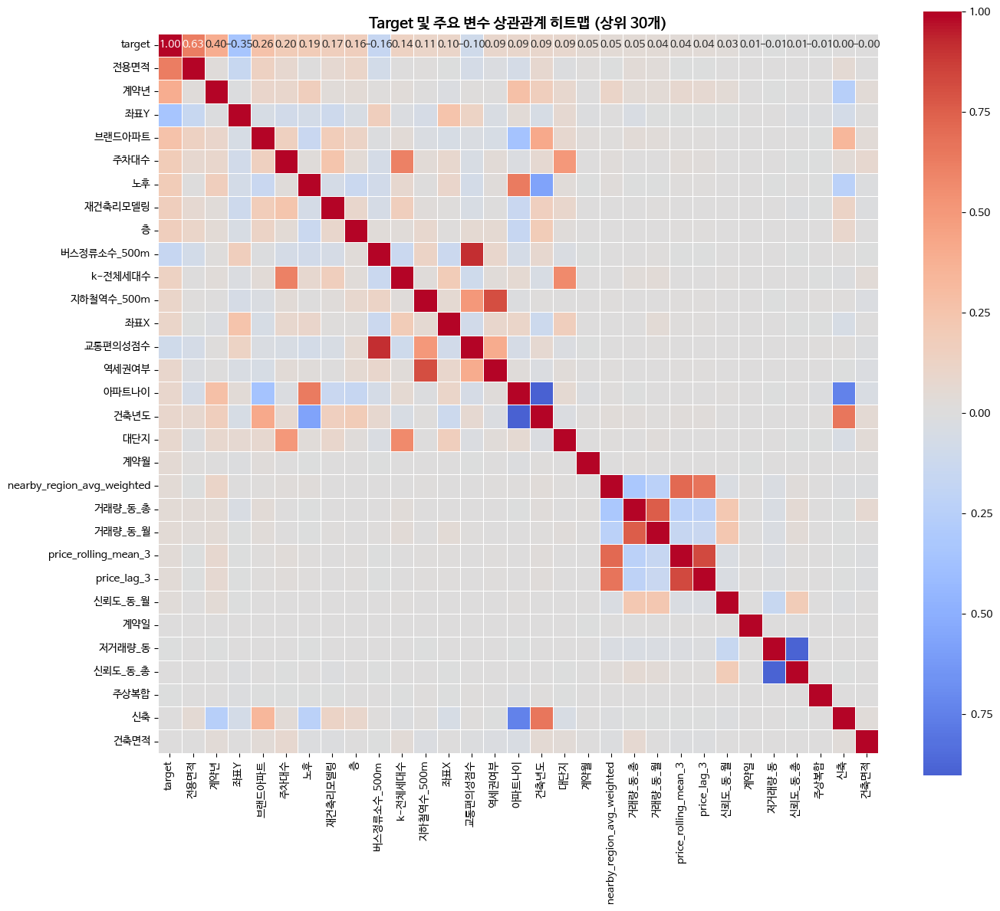

In [57]:
# 수치형 변수만 선택
# target과의 상관계수 계산
correlations = train_for_corr[continuous_columns_v2].corr()['target'].abs().sort_values(ascending=False)

top_30_features = correlations.head(31)[1:]  # target 자신 제외
for idx, (feature, corr) in enumerate(top_30_features.items(), 1):
    print(f"   {idx:2d}. {feature:30s}: {corr:.4f}")

# 상관계수 히트맵 생성

plt.figure(figsize=(14, 12))
top_features = correlations.head(31).index.tolist()  # target 포함 상위 30개
corr_matrix = train_for_corr[top_features].corr()

sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', 
            center=0, square=True, linewidths=0.5)
plt.title('Target 및 주요 변수 상관관계 히트맵 (상위 30개)', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

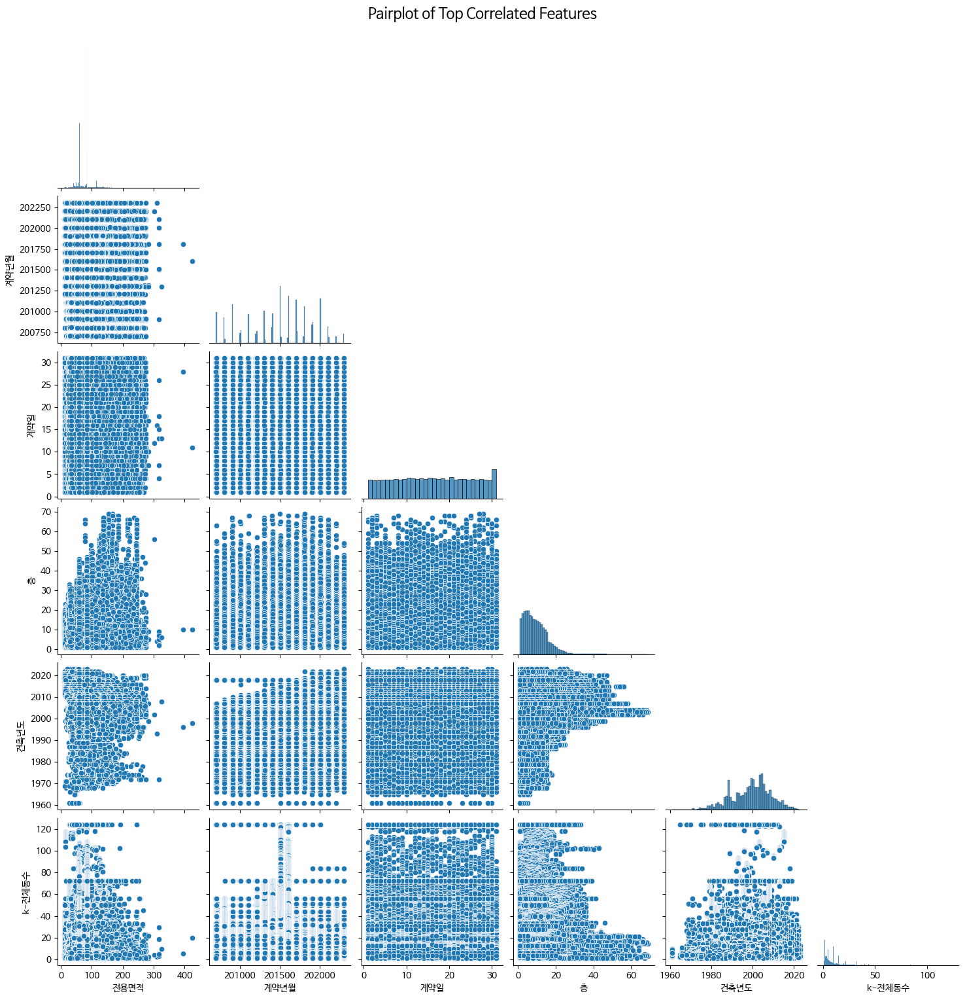

In [ ]:
# 상관관계가 높은 변수들 간의 pairplot 생성
# pairplot_cols = # 수치형 변수만 추려서 list로 생성

# sns.pairplot(train_for_corr[pairplot_cols[:6]], corner=True)
# plt.suptitle('Pairplot of Top Correlated Features', fontsize=16, y=1.02)
# plt.show()

### 9단계: Train/Test 분리

In [58]:
# test_yn 기준 분리
train_processed = full_df[full_df['test_yn'] == 0].copy()
test_processed = full_df[full_df['test_yn'] == 1].copy()

# test_yn 컬럼 삭제
train_processed = train_processed.drop('test_yn', axis=1)
test_processed = test_processed.drop('test_yn', axis=1)

# Train에 target 추가 (로그 변환된 상태)
train_processed['target'] = y_train.values

print(f" 학습 데이터: {train_processed.shape[0]:,}행 x {train_processed.shape[1]}열 (target 포함)")
print(f" 테스트 데이터: {test_processed.shape[0]:,}행 x {test_processed.shape[1]}열")


 학습 데이터: 1,116,350행 x 38열 (target 포함)
 테스트 데이터: 9,272행 x 37열


### 10단계: AutoGluon 모델 학습 

In [60]:
try:
    predictor = TabularPredictor(
        label='target',
        eval_metric='root_mean_squared_error',  # RMSE로 학습 (대회 평가 기준)
        path='./autogluon_models_apt'
    ).fit(
        train_processed,
        time_limit=3600,  # 1시간
        presets='medium_quality',
        verbosity=2
    )
    
    print("\n모델 학습 완료!")
    
except Exception as e:
    print(f"\n오류 발생: {e}")
    exit(1)

Verbosity: 2 (Standard Logging)
=================== System Info ===================
AutoGluon Version:  1.5.0
Python Version:     3.10.13
Operating System:   Linux
Platform Machine:   x86_64
Platform Version:   #184-Ubuntu SMP Tue Oct 31 09:21:49 UTC 2023
CPU Count:          10
Pytorch Version:    2.9.1+cu128
CUDA Version:       12.8
GPU Memory:         GPU 0: 23.69/23.69 GB
Total GPU Memory:   Free: 23.69 GB, Allocated: 0.00 GB, Total: 23.69 GB
GPU Count:          1
Memory Avail:       218.62 GB / 251.62 GB (86.9%)
Disk Space Avail:   1520.27 GB / 1830.73 GB (83.0%)
Presets specified: ['medium_quality']
Using hyperparameters preset: hyperparameters='default'
Beginning AutoGluon training ... Time limit = 3600s
AutoGluon will save models to "/root/apt/autogluon_models_apt"
Train Data Rows:    1116350
Train Data Columns: 37
Label Column:       target
AutoGluon infers your prediction problem is: 'regression' (because dtype of label-column == float and many unique label-values observed).
	

[1000]	valid_set's rmse: 0.0932425
[2000]	valid_set's rmse: 0.0821878
[3000]	valid_set's rmse: 0.077103
[4000]	valid_set's rmse: 0.0741241
[5000]	valid_set's rmse: 0.0721985
[6000]	valid_set's rmse: 0.0708206
[7000]	valid_set's rmse: 0.0698226
[8000]	valid_set's rmse: 0.068986
[9000]	valid_set's rmse: 0.0683134
[10000]	valid_set's rmse: 0.0677632


	-0.0678	 = Validation score   (-root_mean_squared_error)
	325.34s	 = Training   runtime
	5.41s	 = Validation runtime
Fitting model: LightGBM ... Training model for up to 3263.59s of the 3263.59s of remaining time.
	Fitting with cpus=10, gpus=0, mem=1.1/219.7 GB


[1000]	valid_set's rmse: 0.0762511
[2000]	valid_set's rmse: 0.0696224
[3000]	valid_set's rmse: 0.0671205
[4000]	valid_set's rmse: 0.0658456
[5000]	valid_set's rmse: 0.0650365
[6000]	valid_set's rmse: 0.0644902
[7000]	valid_set's rmse: 0.0640617
[8000]	valid_set's rmse: 0.0637581
[9000]	valid_set's rmse: 0.0635287
[10000]	valid_set's rmse: 0.0632958


	-0.0633	 = Validation score   (-root_mean_squared_error)
	257.08s	 = Training   runtime
	2.73s	 = Validation runtime
Fitting model: RandomForestMSE ... Training model for up to 3002.90s of the 3002.90s of remaining time.
	Fitting with cpus=10, gpus=0, mem=5.1/222.4 GB
	-0.0952	 = Validation score   (-root_mean_squared_error)
	512.4s	 = Training   runtime
	0.09s	 = Validation runtime
Fitting model: CatBoost ... Training model for up to 2489.23s of the 2489.23s of remaining time.
	Fitting with cpus=10, gpus=0, mem=1.5/221.9 GB
	-0.0729	 = Validation score   (-root_mean_squared_error)
	1877.8s	 = Training   runtime
	0.07s	 = Validation runtime
Fitting model: ExtraTreesMSE ... Training model for up to 611.21s of the 611.21s of remaining time.
	Fitting with cpus=10, gpus=0, mem=5.1/220.5 GB
	-0.0992	 = Validation score   (-root_mean_squared_error)
	197.24s	 = Training   runtime
	0.17s	 = Validation runtime
Fitting model: NeuralNetFastAI ... Training model for up to 413.02s of the 413.01s o


모델 학습 완료!


### 10-1단계: Permutation Importance 기반 변수 선택

In [61]:
try:
    # AutoGluon의 feature_importance는 permutation importance 사용
    feature_importance_df = predictor.feature_importance(train_processed)
    
    # DataFrame인 경우 평균 계산
    if isinstance(feature_importance_df, pd.DataFrame):
        if len(feature_importance_df.columns) > 1:
            feature_importance_series = feature_importance_df.mean(axis=1)
        else:
            feature_importance_series = feature_importance_df.iloc[:, 0]
    else:
        feature_importance_series = feature_importance_df
    
    # 절대값 기준 정렬
    feature_importance_series = feature_importance_series.abs().sort_values(ascending=False)
    
    print("\nPermutation Importance 상위 30개 변수:")
    top_30_features = feature_importance_series.head(30)
    for idx, (feature, score) in enumerate(top_30_features.items(), 1):
        print(f"   {idx:2d}. {feature:35s}: {score:.6f}")
    
    # 중요도가 거의 0인 변수 찾기 (임계값: 0.09)
    low_importance_threshold = 0.09
    low_importance_features = feature_importance_series[feature_importance_series.abs() < low_importance_threshold]
    
    print(f"\n중요도가 매우 낮은 변수 ({low_importance_threshold} 미만): {len(low_importance_features)}개")
    if len(low_importance_features) > 0:
        print(f" - 변수 목록 (상위 20개만 표시):")
        for idx, (feature, score) in enumerate(low_importance_features.head(20).items(), 1):
            print(f"     {idx:2d}. {feature:35s}: {score:.6f}")
    else:
        print("모든 변수가 어느 정도 중요도를 가지고 있습니다")
    
    # 변수 중요도를 파일로 저장
    feature_importance_series.to_csv('feature_importance_scores.csv', header=['importance'])
    print(f"\n변수 중요도 저장: feature_importance_scores.csv")
    
except Exception as e:
    print(f"Permutation Importance 계산 중 오류: {e}")
    print(" - 계속 진행합니다...")

Computing feature importance via permutation shuffling for 37 features using 5000 rows with 5 shuffle sets...
	628.1s	= Expected runtime (125.62s per shuffle set)
	531.0s	= Actual runtime (Completed 5 of 5 shuffle sets)



Permutation Importance 상위 30개 변수:
    1. 전용면적                               : 1.038277
    2. 계약년                                : 1.008675
    3. 구                                  : 0.935810
    4. 아파트명                               : 0.900337
    5. 저거래량_동                             : 0.900169
    6. 동                                  : 0.886075
    7. 건축년도                               : 0.856108
    8. 신뢰도_동_총                            : 0.853176
    9. 신뢰도_동_월                            : 0.851504
   10. 좌표Y                                : 0.851410
   11. 브랜드아파트                             : 0.847291
   12. 계약월                                : 0.845861
   13. 층                                  : 0.840659
   14. 좌표X                                : 0.838120
   15. 아파트나이                              : 0.838077
   16. k-복도유형                             : 0.837198
   17. 주상복합                               : 0.836660
   18. price_rolling_mean_3               : 0.835348
   19. 지하철역

### 11단계: 모델 평가 및 시각화


모델 성능 리더보드 (상위 10개):
                 model  score_val              eval_metric  pred_time_val     fit_time  pred_time_val_marginal  fit_time_marginal  stack_level  can_infer  fit_order
0  WeightedEnsemble_L2  -0.061329  root_mean_squared_error       8.336091  2830.500836                0.000309           0.015289            2       True          8
1             LightGBM  -0.063296  root_mean_squared_error       2.731150   257.076919                2.731150         257.076919            1       True          2
2      NeuralNetFastAI  -0.066262  root_mean_squared_error       0.118531   370.272049                0.118531         370.272049            1       True          6
3           LightGBMXT  -0.067761  root_mean_squared_error       5.413023   325.341061                5.413023         325.341061            1       True          1
4             CatBoost  -0.072922  root_mean_squared_error       0.073078  1877.795519                0.073078        1877.795519            1       True


학습 데이터 성능 지표 (로그 스케일):
 - MAE:  0.0373
 - RMSE: 0.0568 ⭐ (학습/평가 지표)
 - R²:   0.9919

학습 데이터 성능 지표 (원본 스케일, 단위: 만원):
 - MAE:  2,183.00만원
 - RMSE: 4,490.90만원 ⭐
 - R²:   0.9906


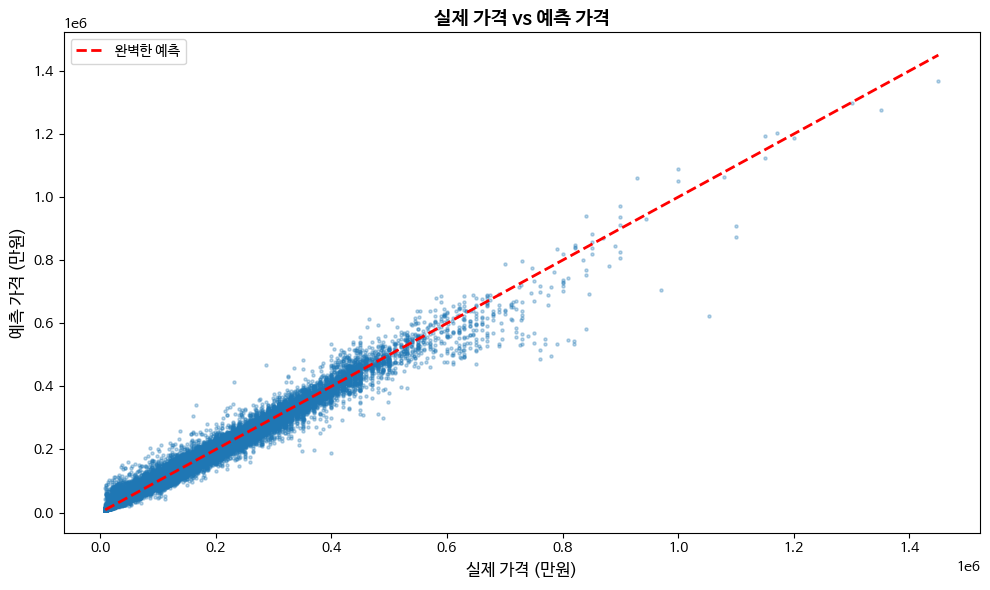

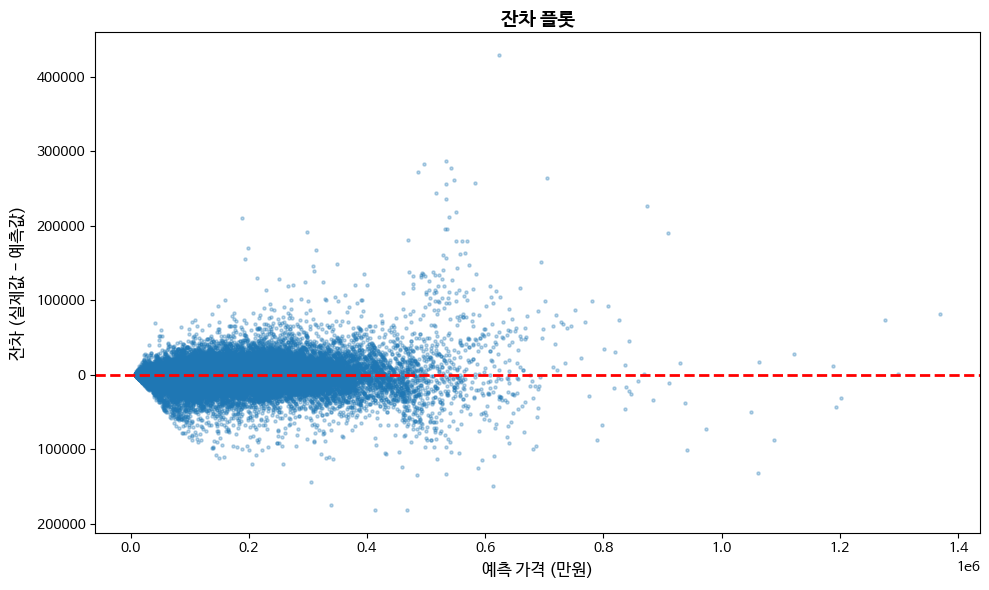

Computing feature importance via permutation shuffling for 37 features using 5000 rows with 5 shuffle sets...
	624.81s	= Expected runtime (124.96s per shuffle set)
	541.13s	= Actual runtime (Completed 5 of 5 shuffle sets)



상위 20개 중요 변수:
    1. 전용면적                          : 1.0383
    2. 계약년                           : 1.0087
    3. 구                             : 0.9358
    4. 아파트명                          : 0.9003
    5. 저거래량_동                        : 0.9002
    6. 동                             : 0.8861
    7. 건축년도                          : 0.8561
    8. 신뢰도_동_총                       : 0.8532
    9. 신뢰도_동_월                       : 0.8515
   10. 좌표Y                           : 0.8514
   11. 브랜드아파트                        : 0.8473
   12. 계약월                           : 0.8459
   13. 층                             : 0.8407
   14. 좌표X                           : 0.8381
   15. 아파트나이                         : 0.8381
   16. k-복도유형                        : 0.8372
   17. 주상복합                          : 0.8367
   18. price_rolling_mean_3          : 0.8353
   19. 지하철역수_500m                    : 0.8352
   20. price_lag_3                   : 0.8352


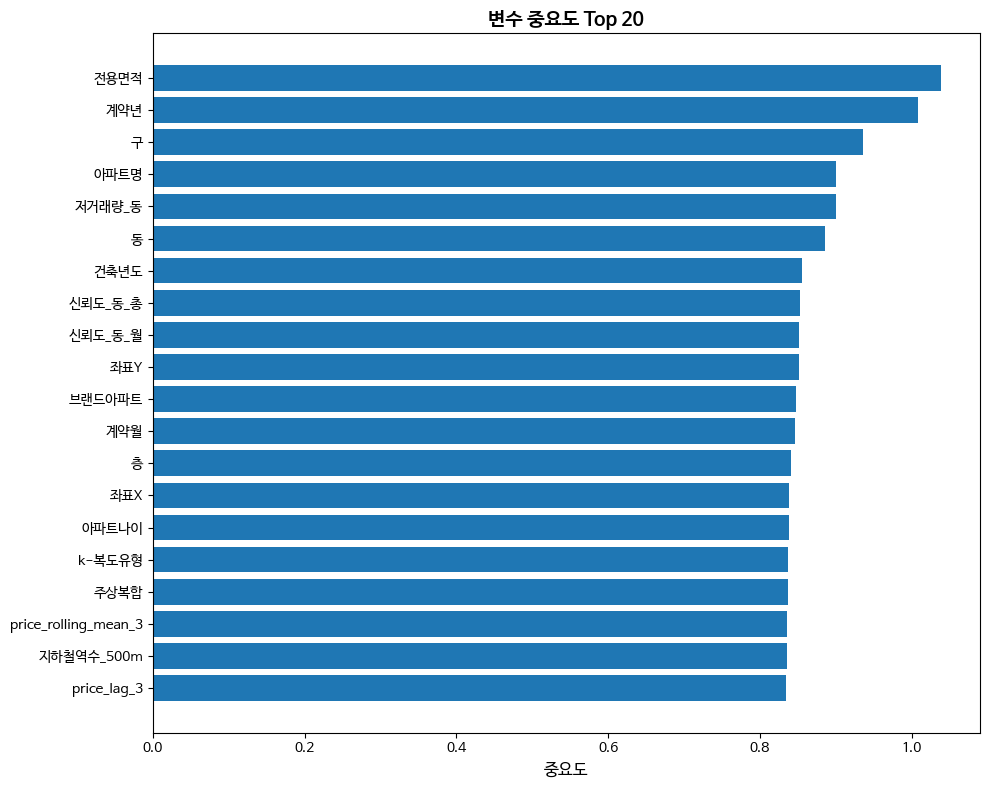

In [62]:
# 리더보드 확인
leaderboard = predictor.leaderboard(silent=True)
print("\n모델 성능 리더보드 (상위 10개):")
print(leaderboard.head(10).to_string())

best_model_name = leaderboard.iloc[0]['model']
best_score = leaderboard.iloc[0]['score_val']

print(f"\n최고 성능 모델: {best_model_name}")
print(f"검증 RMSE: {abs(best_score):.4f} (로그 스케일)")

# 학습 데이터로 예측 (평가용)
print(f"\n학습 데이터 예측 중...")
train_predictions = predictor.predict(train_processed)
actual_prices_log = train_processed['target']

# 로그 스케일에서 성능 지표 계산
mae_log = mean_absolute_error(actual_prices_log, train_predictions)
rmse_log = np.sqrt(mean_squared_error(actual_prices_log, train_predictions))
r2_log = r2_score(actual_prices_log, train_predictions)

print(f"\n학습 데이터 성능 지표 (로그 스케일):")
print(f" - MAE:  {mae_log:.4f}")
print(f" - RMSE: {rmse_log:.4f} ⭐ (학습/평가 지표)")
print(f" - R²:   {r2_log:.4f}")

# 원래 스케일로 역변환하여 성능 지표 계산
actual_prices_original = np.expm1(actual_prices_log)
predictions_original = np.expm1(train_predictions)

mae_original = mean_absolute_error(actual_prices_original, predictions_original)
rmse_original = np.sqrt(mean_squared_error(actual_prices_original, predictions_original))
r2_original = r2_score(actual_prices_original, predictions_original)

print(f"\n학습 데이터 성능 지표 (원본 스케일, 단위: 만원):")
print(f" - MAE:  {mae_original:,.2f}만원")
print(f" - RMSE: {rmse_original:,.2f}만원 ⭐")
print(f" - R²:   {r2_original:.4f}")

# 시각화 생성
# 1. 실제값 vs 예측값 산점도
plt.figure(figsize=(10, 6))
plt.scatter(actual_prices_original, predictions_original, alpha=0.3, s=5)
plt.plot([actual_prices_original.min(), actual_prices_original.max()], 
         [actual_prices_original.min(), actual_prices_original.max()], 
         'r--', linewidth=2, label='완벽한 예측')
plt.xlabel('실제 가격 (만원)', fontsize=12)
plt.ylabel('예측 가격 (만원)', fontsize=12)
plt.title('실제 가격 vs 예측 가격', fontsize=14, fontweight='bold')
plt.legend()
plt.tight_layout()
plt.show()

# 2. 잔차 플롯
residuals = actual_prices_original - predictions_original
plt.figure(figsize=(10, 6))
plt.scatter(predictions_original, residuals, alpha=0.3, s=5)
plt.axhline(y=0, color='r', linestyle='--', linewidth=2)
plt.xlabel('예측 가격 (만원)', fontsize=12)
plt.ylabel('잔차 (실제값 - 예측값)', fontsize=12)
plt.title('잔차 플롯', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

# 3. 변수 중요도
try:
    feature_importance = predictor.feature_importance(train_processed)
    
    # feature_importance가 DataFrame인 경우 (여러 모델의 중요도)
    if isinstance(feature_importance, pd.DataFrame):
        # 모든 모델의 평균 중요도 사용
        if len(feature_importance.columns) > 1:
            feature_importance = feature_importance.mean(axis=1)
        else:
            # 컬럼이 하나면 Series로 변환
            feature_importance = feature_importance.iloc[:, 0]
    
    # 절대값 기준으로 정렬
    feature_importance = feature_importance.abs().sort_values(ascending=False)
    
    print(f"\n상위 20개 중요 변수:")
    top_features_imp = feature_importance.head(20)
    for idx, (feature, score) in enumerate(top_features_imp.items(), 1):
        print(f"   {idx:2d}. {feature:30s}: {score:.4f}")
     
    # 변수 중요도 시각화
    plt.figure(figsize=(10, 8))
    plt.barh(range(len(top_features_imp)), top_features_imp.values)
    plt.yticks(range(len(top_features_imp)), top_features_imp.index)
    plt.xlabel('중요도', fontsize=12)
    plt.title('변수 중요도 Top 20', fontsize=14, fontweight='bold')
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.show()
    
except Exception as e:
    print(f"변수 중요도 분석 중 오류: {e}")

### 12단계: 테스트 예측 및 제출 파일 생성

In [63]:
test_predictions_log = predictor.predict(test_processed)

# 로그 역변환 (원본 스케일로)
test_predictions_original = np.expm1(test_predictions_log)

print(f"\n예측 가격 통계 (단위: 만원):")
print(f" - 최소값: {test_predictions_original.min():,.2f}")
print(f" - 최대값: {test_predictions_original.max():,.2f}")
print(f" - 평균값: {test_predictions_original.mean():,.2f}")
print(f" - 중앙값: {np.median(test_predictions_original):,.2f}")

# 제출 파일 생성 (정수형으로 제출)
submission = pd.DataFrame({
    'target': test_predictions_original.astype(int)
})

# 결측치 및 음수 확인
null_count = submission['target'].isnull().sum()
negative_count = (submission['target'] < 0).sum()

if null_count > 0 or negative_count > 0:
    print(f"\n파일에 오류가 있습니다.")

# 파일 저장
submission_file = 'submission_x86.csv'
submission.to_csv(submission_file, index=False)



예측 가격 통계 (단위: 만원):
 - 최소값: 9,174.58
 - 최대값: 1,128,704.12
 - 평균값: 107,114.73
 - 중앙값: 88,141.51
